<a href="https://colab.research.google.com/github/yecatstevir/farmer_market_food_insecurity/blob/main/src/Clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Clustering Farmers' Market Data and Food Insecurity
Contains data on farmer's markets, food insecurity, and some demographic information like median county income per county

- ### Visualize the data based on location, total markets, as well as market locations and then markets that accept SNAP and WIC
  - Map 1 : All Counties
  - Map 2 : Total number of market types per county
  - Map 3 : All locations of markets
  - Map 4 : All Markets that accept SNAP and WIC

- ### K-Means
#### Feature extraction with Random Forest
  - Map 1 : The 5 clusters across the US
  - 10 Horizontal Bar charts for Top 10 features and Bottom 10 features for all 5 clusters

- ### DBSCAN
#### Epsilon using KNN


In [1]:
# Mount Google Drive to notebook
from google.colab import drive, files
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [40]:
import pandas as pd
import numpy as np
import random
import re

from sklearn.neighbors import NearestNeighbors as knn
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans, DBSCAN 

!pip install haversine
from haversine import haversine
import scipy.spatial

from IPython.display import set_matplotlib_formats
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from textwrap import wrap
import seaborn as sns
import folium



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
path = '/content/gdrive/MyDrive/FIS/team20_clean_MM_FA_FM_county_202207191713.csv'
data = pd.read_csv(path)

In [4]:
#path_bridge = '/content/gdrive/MyDrive/FIS/state_percent_market_geodf.csv'
#br_df = pd.read_csv(path_bridge)

In [4]:
# Open text file and extract lat and long coords 
path_txt = '/content/gdrive/MyDrive/FIS/2021_Gaz_counties_national.txt'
lat_long_df = pd.read_csv(path_txt, sep="\t")
lat_long_df = lat_long_df.rename(columns = {'GEOID': 'FIPS',
                                            'INTPTLONG                                                                                                               ':'INTPTLONG'})
lat_long_df = lat_long_df[['FIPS', 'INTPTLAT', 'INTPTLONG']]
lat_long_df                                                                                                      

,FIPS,INTPTLAT,INTPTLONG
0,1001,32.532237,-86.646440
1,1003,30.659218,-87.746067
2,1005,31.870253,-85.405104
3,1007,33.015893,-87.127148
4,1009,33.977358,-86.566440
...,...,...,...
3216,72145,18.455128,-66.397883
3217,72147,18.125418,-65.432474
3218,72149,18.130718,-66.472244
3219,72151,18.059858,-65.859871


In [6]:
data['State'] = data['State'].apply(lambda x : str(x))
#br_df['State_name'] = br_df['State_name'].apply(lambda x: str(x))
#data2 = pd.merge(data, br_df, left_on= 'State', right_on = 'State_name')
data = pd.merge(data, lat_long_df, on = 'FIPS')
data.head(10)

,Unnamed: 0,FIPS,State,2019 Food Insecurity Rate,# of Food Insecure Persons in 2019,Low Threshold in state,Low Threshold Type,High Threshold in state,High Threshold Type,2019 Child food insecurity rate,...,TractSeniors,lahunvhalf,LALOWI05_10,PovertyRate,lalowihalf,TractLOWI,Urban,MedianFamilyIncome,INTPTLAT,INTPTLONG
0,0,1001,Alabama,15.7,8670,130,SNAP,185,Other Nutrition Program,19.6,...,545.500000,87.009806,858.229840,16.130786,1293.160619,1436.916667,12.0,69337.500000,32.532237,-86.646440
1,1,1003,Alabama,13.4,28590,130,SNAP,185,Other Nutrition Program,14.4,...,986.064516,70.270895,1054.515175,11.845546,1552.104536,1865.903226,31.0,72665.741935,30.659218,-87.746067
2,2,1005,Alabama,20.7,5250,130,SNAP,185,Other Nutrition Program,32.4,...,434.333333,82.501394,556.630110,29.299325,1322.333301,1341.444444,9.0,44792.444444,31.870253,-85.405104
3,3,1007,Alabama,16.3,3680,130,SNAP,185,Other Nutrition Program,21.8,...,726.500000,110.154647,25.542561,12.193524,2087.128682,1992.000000,4.0,60645.500000,33.015893,-87.127148
4,4,1009,Alabama,14.5,8380,130,SNAP,185,Other Nutrition Program,15.4,...,937.666667,91.316874,2038.838706,14.850748,2200.824287,2310.555556,9.0,60437.666667,33.977358,-86.566440
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3136,3137,56037,Wyoming,11.3,4940,130,SNAP,185,Other Nutrition Program,14.7,...,303.583333,31.090187,358.935475,11.602957,772.067357,918.000000,12.0,85896.833333,41.660328,-108.875677
3137,3138,56039,Wyoming,9.0,2100,130,SNAP,185,Other Nutrition Program,7.2,...,524.500000,35.900055,287.517377,7.443584,891.379629,1161.500000,4.0,112766.750000,44.048662,-110.426087
3138,3139,56041,Wyoming,12.6,2590,130,SNAP,185,Other Nutrition Program,16.2,...,624.666667,94.501266,96.730785,12.443318,1890.085769,2180.666667,3.0,70347.666667,41.284726,-110.558947
3139,3140,56043,Wyoming,11.6,930,130,SNAP,185,Other Nutrition Program,16.4,...,502.666667,35.055937,252.691081,12.547283,461.128157,776.000000,3.0,67003.666667,43.878831,-107.669052


In [7]:
print("max median income:", data['MedianFamilyIncome'].max()) #bin
print("min median income:", data['MedianFamilyIncome'].min())
print(data['Low Threshold Type'].unique()) #drop for now
print(data['High Threshold Type'].unique()) # drop for now

max median income: 181144.0
min median income: 21445.0
['SNAP' 'SNAP, Other Nutrition Programs']
['Other Nutrition Program' 'SNAP, Other Nutrition Programs']


In [8]:
# Get names of all columns to curate into final model
data.columns.tolist()

['Unnamed: 0',
 'FIPS',
 'State',
 '2019 Food Insecurity Rate',
 '# of Food Insecure Persons in 2019',
 'Low Threshold in state',
 'Low Threshold Type',
 'High Threshold in state',
 'High Threshold Type',
 '2019 Child food insecurity rate',
 '# of Food Insecure Children in 2019',
 '% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
 '% food insecure children in HH w/ HH incomes above 185 FPL in 2019',
 '2019 Cost Per Meal',
 '2019 Weighted Annual Food Budget Shortfall',
 'P_FI_Below_Low_Threshold',
 'P_FI_Between_Thresholds',
 'P_FI_Above_High_Threshold',
 'County',
 'count_OFM',
 'count_SNAP_participation_OFM',
 'count_FNAP_participation_OFM',
 'count_WIC_participation_OFM',
 'count_SFMNP_participation_OFM',
 'count_CSA',
 'count_SNAP_participation_CSA',
 'count_FNAP_participation_CSA',
 'count_WIC_participation_CSA',
 'count_SFMNP_participation_CSA',
 'count_FM',
 'count_SNAP_participation_FM',
 'count_FNAP_participation_FM',
 'count_WIC_participation_FM',
 'count_S

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3141 entries, 0 to 3140
Data columns (total 47 columns):
 #   Column                                                              Non-Null Count  Dtype  
---  ------                                                              --------------  -----  
 0   Unnamed: 0                                                          3141 non-null   int64  
 1   FIPS                                                                3141 non-null   int64  
 2   State                                                               3141 non-null   object 
 3   2019 Food Insecurity Rate                                           3141 non-null   float64
 4   # of Food Insecure Persons in 2019                                  3141 non-null   int64  
 5   Low Threshold in state                                              3141 non-null   int64  
 6   Low Threshold Type                                                  3141 non-null   object 
 7   High Threshold 

In [10]:
columns_to_keep = [
 'FIPS',
 '2019 Food Insecurity Rate',
 '# of Food Insecure Persons in 2019',
 #'Low Threshold in state',
 #'High Threshold in state',
 '2019 Child food insecurity rate',
 '# of Food Insecure Children in 2019',
 '% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
 '% food insecure children in HH w/ HH incomes above 185 FPL in 2019',
 '2019 Cost Per Meal',
 '2019 Weighted Annual Food Budget Shortfall',
 'P_FI_Below_Low_Threshold',
 'P_FI_Between_Thresholds',
 'P_FI_Above_High_Threshold',
 'count_OFM',
 'count_SNAP_participation_OFM',
 'count_FNAP_participation_OFM',
 'count_WIC_participation_OFM',
 'count_SFMNP_participation_OFM',
 'count_CSA',
 'count_SNAP_participation_CSA',
 'count_FNAP_participation_CSA',
 'count_WIC_participation_CSA',
 'count_SFMNP_participation_CSA',
 'count_FM',
 'count_SNAP_participation_FM',
 'count_FNAP_participation_FM',
 'count_WIC_participation_FM',
 'count_SFMNP_participation_FM',
 'TractSNAP',
 'TractHUNV',
 'TractKids',
 'TractSeniors',
 'lahunvhalf',
 #'LALOWI05_10',
 'PovertyRate',
 'lalowihalf',
 'TractLOWI',
 'Urban',
 'MedianFamilyIncome',
 #'STATE',
 'INTPTLAT',
 'INTPTLONG',
 'County'
 ]

data_num_df = data[columns_to_keep]
data_num_df.info()

,FIPS,2019 Food Insecurity Rate,# of Food Insecure Persons in 2019,2019 Child food insecurity rate,# of Food Insecure Children in 2019,% food insecure children in HH w/ HH incomes below 185 FPL in 2019,% food insecure children in HH w/ HH incomes above 185 FPL in 2019,2019 Cost Per Meal,2019 Weighted Annual Food Budget Shortfall,P_FI_Below_Low_Threshold,...,TractSeniors,lahunvhalf,PovertyRate,lalowihalf,TractLOWI,Urban,MedianFamilyIncome,INTPTLAT,INTPTLONG,County
0,1001,15.7,8670,19.6,2590.0,69,31,3.00,4439000.0,48.6,...,545.500000,87.009806,16.130786,1293.160619,1436.916667,12.0,69337.500000,32.532237,-86.646440,Autauga County
1,1003,13.4,28590,14.4,6680.0,79,21,3.66,17895000.0,39.1,...,986.064516,70.270895,11.845546,1552.104536,1865.903226,31.0,72665.741935,30.659218,-87.746067,Baldwin County
2,1005,20.7,5250,32.4,1720.0,72,28,3.11,2788000.0,66.3,...,434.333333,82.501394,29.299325,1322.333301,1341.444444,9.0,44792.444444,31.870253,-85.405104,Barbour County
3,1007,16.3,3680,21.8,1010.0,89,11,2.96,1861000.0,47.8,...,726.500000,110.154647,12.193524,2087.128682,1992.000000,4.0,60645.500000,33.015893,-87.127148,Bibb County
4,1009,14.5,8380,15.4,2060.0,100,0,3.04,4357000.0,46.2,...,937.666667,91.316874,14.850748,2200.824287,2310.555556,9.0,60437.666667,33.977358,-86.566440,Blount County
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3136,56037,11.3,4940,14.7,1700.0,60,40,3.36,2839000.0,41.2,...,303.583333,31.090187,11.602957,772.067357,918.000000,12.0,85896.833333,41.660328,-108.875677,Sweetwater County
3137,56039,9.0,2100,7.2,320.0,81,19,4.61,1655000.0,33.0,...,524.500000,35.900055,7.443584,891.379629,1161.500000,4.0,112766.750000,44.048662,-110.426087,Teton County
3138,56041,12.6,2590,16.2,960.0,59,41,3.06,1357000.0,50.4,...,624.666667,94.501266,12.443318,1890.085769,2180.666667,3.0,70347.666667,41.284726,-110.558947,Uinta County
3139,56043,11.6,930,16.4,330.0,76,24,3.24,515000.0,45.1,...,502.666667,35.055937,12.547283,461.128157,776.000000,3.0,67003.666667,43.878831,-107.669052,Washakie County


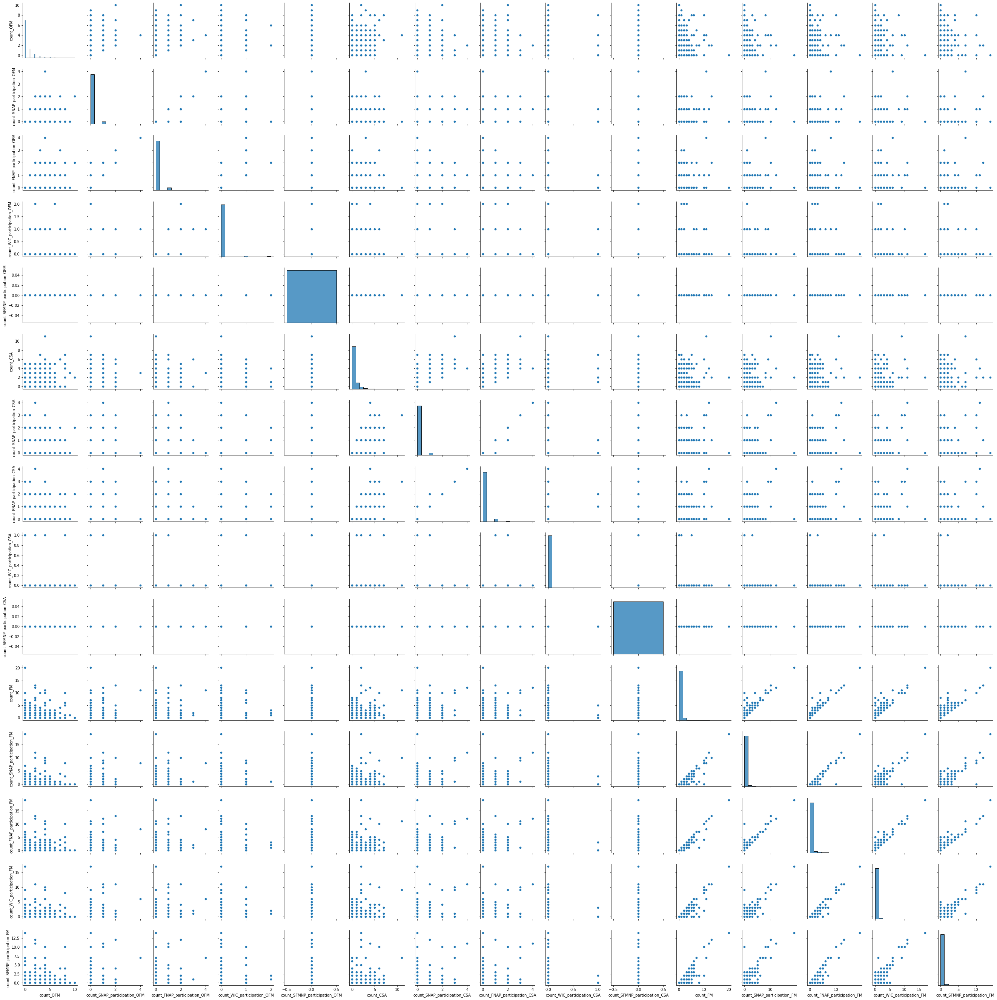

In [ ]:
#@title Pairplot of Farmers market data, Cell takes too long to run
import seaborn as sns
cols = ['count_OFM', 
'count_SNAP_participation_OFM',                                        
'count_FNAP_participation_OFM',                                      
'count_WIC_participation_OFM',                                      
'count_SFMNP_participation_OFM',                                       
'count_CSA',                                                           
'count_SNAP_participation_CSA',                                       
'count_FNAP_participation_CSA',                                     
'count_WIC_participation_CSA',                                     
'count_SFMNP_participation_CSA',                                       
'count_FM',                                                           
'count_SNAP_participation_FM',                                      
'count_FNAP_participation_FM',                                       
'count_WIC_participation_FM',                                       
'count_SFMNP_participation_FM']    
sns.pairplot(data_num_df[cols])

In [12]:
data_num_df= data_num_df.dropna()
data_num_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3136 entries, 0 to 3140
Data columns (total 40 columns):
 #   Column                                                              Non-Null Count  Dtype  
---  ------                                                              --------------  -----  
 0   FIPS                                                                3136 non-null   int64  
 1   2019 Food Insecurity Rate                                           3136 non-null   float64
 2   # of Food Insecure Persons in 2019                                  3136 non-null   int64  
 3   2019 Child food insecurity rate                                     3136 non-null   float64
 4   # of Food Insecure Children in 2019                                 3136 non-null   float64
 5   % food insecure children in HH w/ HH incomes below 185 FPL in 2019  3136 non-null   int64  
 6   % food insecure children in HH w/ HH incomes above 185 FPL in 2019  3136 non-null   int64  
 7   2019 Cost Per M

## Visualize the Data 
- All the Latitude and Long Coordinates in the dataset (All US counties)
- Total number of Farmer's Markets in each County
- All Farmers market type locations
- All Farmers market types locations that accept SNAP and WIC

In [37]:
## All Counties in the US
m = folium.Map(location=[data_num_df.INTPTLAT.mean(), data_num_df.INTPTLONG.mean()], zoom_start=9, 
               tiles='OpenStreet Map')
for _, row in data_num_df.iterrows():
    folium.CircleMarker(
        location=[row.INTPTLAT, row.INTPTLONG],
        radius=.2,
        popup=re.sub(r'[^a-zA-Z ]+', '', row.County),
        color='#1787FE',
        fill=True,
        fill_colour='#1787FE'
    ).add_to(m)

m

In [13]:
# Total number of types of farmers markets in each county
data_num_df['total'] = data_num_df['count_OFM'] + data_num_df['count_CSA'] + data_num_df['count_FM']

fig = go.Figure(data=go.Scattergeo(
        locationmode = 'USA-states',
        lon = data_num_df['INTPTLONG'],
        lat = data_num_df['INTPTLAT'],
        text = data_num_df['County'],
        mode = 'markers',
        marker = dict(
            size = data_num_df['total'],
            opacity = 0.8,
            reversescale=True,
            autocolorscale = False,
            symbol = 'circle',
            line = dict(
                width=1,
                #color='rgba(102, 102, 102)'
            ),
            colorscale = 'oryel_r',
            cmin = 0,
            color = data_num_df['total'],
            cmax = data_num_df['total'].max(),
            colorbar_title="Total Markets<br>count per County"
        )))

fig.update_layout(
        title = "Total Markets in the US<br>(Hover for County Name)",
        geo = dict(
            scope='usa',
            projection_type='albers usa',
            showland = True
        ),
    )
fig.show()


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [141]:
# All Farmers market types locations 
m = folium.Map(location=[fm_csa_om.latitude.mean(), fm_csa_om.longitude.mean()], zoom_start=9, 
               tiles='cartodbpositron')
for _, row in fm_csa_om.iterrows():
    folium.CircleMarker(
        location=[row.latitude, row.longitude],
        radius=.5,
        popup=re.sub(r'[^a-zA-Z ]+', '', row.listing_name),
        color='#ff6c19',
        fill=True,
        fill_colour='#ff6c19'
    ).add_to(m)

m

In [150]:
# All famrers types locations that accept snap and wic 
all_mrk_w_benefits = fm_csa_om.loc[(fm_csa_om['WIC'] == 1) & (fm_csa_om['SNAP'] == 1)]

m = folium.Map(location=[all_mrk_w_benefits.latitude.mean(), 
                         all_mrk_w_benefits.longitude.mean()], 
               zoom_start=9, 
               tiles='cartodbpositron'
               )

for _, row in all_mrk_w_benefits.iterrows():
    folium.CircleMarker(
        location=[row.latitude, row.longitude],
        radius=.5,
        popup=re.sub(r'[^a-zA-Z ]+', '', row.listing_name),
        color='#ff6c19',
        fill=True,
        fill_colour='#ff6c19'
    ).add_to(m)

m

## Extract Features we want to include in the models
- Full dataset
- Counties that have Farmer's markets
- Calculate features:
  - Distance metrics: Haversine

In [14]:
# Get the X val
#X = data_num_df.values

columns_to_keep = [
 #'FIPS',
 '2019 Food Insecurity Rate',
 '# of Food Insecure Persons in 2019',
 #'Low Threshold in state',
 #'High Threshold in state',
 '2019 Child food insecurity rate',
 '# of Food Insecure Children in 2019',
 '% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
 '% food insecure children in HH w/ HH incomes above 185 FPL in 2019',
 '2019 Cost Per Meal',
 '2019 Weighted Annual Food Budget Shortfall',
 'P_FI_Below_Low_Threshold',
 'P_FI_Between_Thresholds',
 'P_FI_Above_High_Threshold',
 'count_OFM',
 'count_SNAP_participation_OFM',
 'count_FNAP_participation_OFM',
 'count_WIC_participation_OFM',
 'count_SFMNP_participation_OFM',
 'count_CSA',
 'count_SNAP_participation_CSA',
 'count_FNAP_participation_CSA',
 'count_WIC_participation_CSA',
 'count_SFMNP_participation_CSA',
 'count_FM',
 'count_SNAP_participation_FM',
 'count_FNAP_participation_FM',
 'count_WIC_participation_FM',
 'count_SFMNP_participation_FM',
 'TractSNAP',
 'TractHUNV',
 'TractKids',
 'TractSeniors',
 'lahunvhalf',
 #'LALOWI05_10',
 'PovertyRate',
 'lalowihalf',
 'TractLOWI',
 'Urban',
 'MedianFamilyIncome',
 #'STATE',
 'INTPTLAT',
 'INTPTLONG',
 #'County'
 ]
#data_num_df = data_num_df[columns_to_keep]
data_num_df2 = data_num_df[columns_to_keep]
#standardize = data_num_df2.iloc[:, :-2]

In [15]:
data_num_df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3136 entries, 0 to 3140
Data columns (total 38 columns):
 #   Column                                                              Non-Null Count  Dtype  
---  ------                                                              --------------  -----  
 0   2019 Food Insecurity Rate                                           3136 non-null   float64
 1   # of Food Insecure Persons in 2019                                  3136 non-null   int64  
 2   2019 Child food insecurity rate                                     3136 non-null   float64
 3   # of Food Insecure Children in 2019                                 3136 non-null   float64
 4   % food insecure children in HH w/ HH incomes below 185 FPL in 2019  3136 non-null   int64  
 5   % food insecure children in HH w/ HH incomes above 185 FPL in 2019  3136 non-null   int64  
 6   2019 Cost Per Meal                                                  3136 non-null   float64
 7   2019 Weighted A

### Calculate distances for : (are not used in these models)
- county data set 

---
to do:
- farmers dataset



In [ ]:
#@title Haversine distances calculated between counties and a random county (could sample more counties to make these calculations) * (not used in our data)
def distance(p1,p2):
  #(lat, long)
  first_p = [p1[0], p1[1]]
  second_p = [p2[0], p2[1]]
  #print(first_p, second_p)

  return haversine(first_p, second_p)
lat_long = data_num_df2[['INTPTLAT', 'INTPTLONG']].values
centroids = lat_long[np.random.choice(np.arange(len(lat_long)),5, False)]
sqdists = scipy.spatial.distance.cdist(centroids, lat_long, lambda u, v: (distance(u,v)**2))

## Standard Scaling: Normalize Features Column-wise before running any models


In [16]:
# Normalize data column-wise  
scaler = StandardScaler()
X_std = scaler.fit_transform(data_num_df2)
X_std.shape


(3136, 38)

In [65]:
#@title Standardized Matrix to Dataframe
# Turn back into dataframe 
#(not necessary but if want to use certain module with Kmeans, will need to include feature names as string)
X_std = pd.DataFrame(X_std, columns= data_num_df2.columns)

# Calculate a Weighted K-means for clustering
## Feature Importance Extraction with RandomForest Decision Tree
- Silhoutte Score
- Elbow Method
- Feature extraction 
- Map Feature importance to clusters
- Visualize the clusters


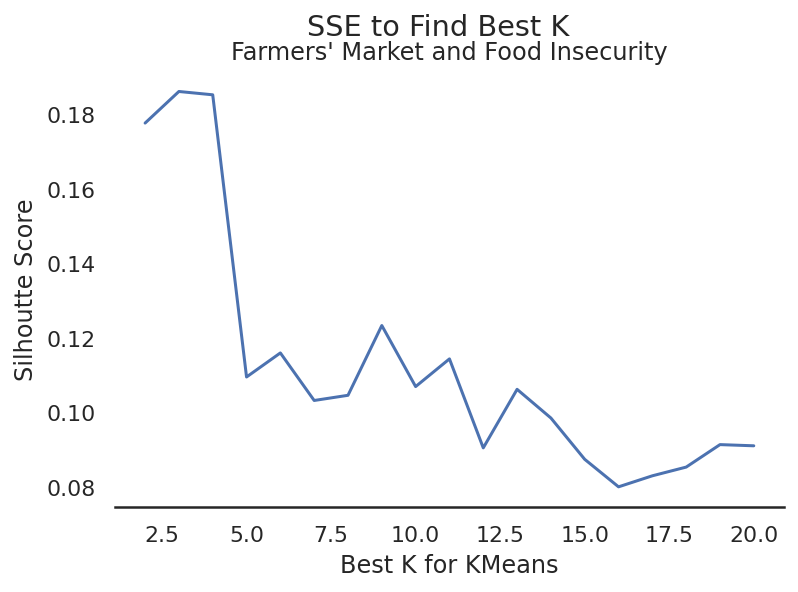

In [35]:
sil_score = []
cost =[]
kl = []
k_max = 20

for k in range(2, k_max+1):
  kmeans2 = KMeans(n_clusters = k).fit(X_std)
  labels = kmeans2.labels_
  sil_score.append(silhouette_score(X_std, labels, metric = 'haversine'))
  kl.append(k)
  cost.append(kmeans2.inertia_)
sil_name = 'elbow.png'
plt.plot(kl, sil_score)
plt.ylabel('Silhoutte Score')
plt.xlabel('Best K for KMeans')
plt.title("Farmers' Market and Food Insecurity")
plt.suptitle('SSE to Find Best K')
#plt.savefig('/content/gdrive/MyDrive/FIS/images{}'.format(sil_name))
plt.show()

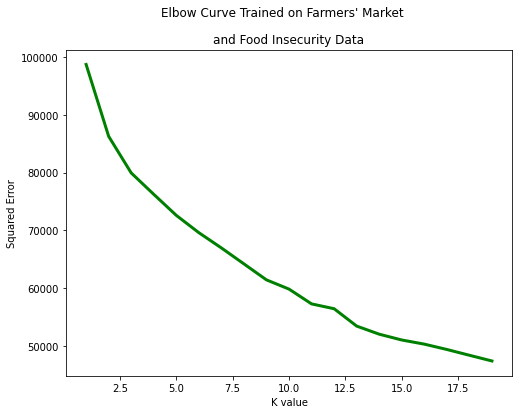

In [68]:
# plot the cost against K values
plt.figure(figsize = (8,6))
plt.plot(range(1, 20), cost, color ='g', linewidth ='3')
plt.title("and Food Insecurity Data")
plt.suptitle("Elbow Curve Trained on Farmers' Market")
plt.xlabel("K value")
plt.ylabel("Squared Error")

#plt.savefig('/content/gdrive/MyDrive/FIS/images{}'.format(elb_name))

plt.show() # clear the plot


In [22]:
# Train Kmeans
n_clusters = 5
clt = KMeans(n_clusters=n_clusters, random_state=0)
model = clt.fit(X_std)
model.cluster_centers_
data_num_df['clusters'] = model.labels_

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [23]:
#Colors for 5 clusters
colors = [
'#CFB5FF',
'#91DBA8',
'#00274C',
'#F6867A',
'#FCC649']

"""
#CFB5FF 0 - Purple
#91DBA8 1 - Green
#00274C 2 - Dark Blue
#F6867A 3 - Red
#FCC649 4 - Yellow
"""

m = folium.Map(location=[data_num_df.INTPTLAT.mean(), data_num_df.INTPTLONG.mean()], zoom_start=9, 
               tiles='cartodbpositron')
for i, row in data_num_df.iterrows():
  if row['clusters'] == -1:
            cluster_color = '#000000'
  else:
    cluster_color = colors[row['clusters']]
    #print(cluster_color, row['clusters'])
    folium.CircleMarker(
            location=[row.INTPTLAT, row.INTPTLONG],
            radius=.25,
            popup=re.sub(r'[^a-zA-Z ]+', '', row.County),
            color=cluster_color,
            fill=True,
            opacity=0.5,
            fill_color=cluster_color
        ).add_to(m)

m



In [24]:
print(data_num_df['clusters'].value_counts())
"""
#CFB5FF 0 - Purple
#91DBA8 1 - Green
#00274C 2 - Dark Blue
#F6867A 3 - Red
#FCC649 4 - Yellow
"""

# One hot encoding the clusters in the dataframe
data_num_df['Purple Cluster 0'] = data_num_df['clusters'].map({0:1, 1:0, 2:0, 3:0, 4:0})
data_num_df['Green Cluster 1'] = data_num_df['clusters'].map({0:0, 1:1, 2:0, 3:0, 4:0})
data_num_df['Dark Blue Cluster 2'] = data_num_df['clusters'].map({0:0, 1:0, 2:1, 3:0, 4:0})
data_num_df['Red Cluster 3'] = data_num_df['clusters'].map({0:0, 1:0, 2:0, 3:1, 4:0})
data_num_df['Yellow Cluster 4'] = data_num_df['clusters'].map({0:0, 1:0, 2:0, 3:0, 4:1})
print("\n", data_num_df["Purple Cluster 0"].value_counts())
print("\n", data_num_df["Green Cluster 1"].value_counts())
print("\n", data_num_df["Dark Blue Cluster 2"].value_counts())
print("\n", data_num_df["Red Cluster 3"].value_counts())
print("\n", data_num_df["Yellow Cluster 4"].value_counts())

4    1064
0    1016
1     794
3     239
2      23
Name: clusters, dtype: int64

 0    2120
1    1016
Name: Purple Cluster 0, dtype: int64

 0    2342
1     794
Name: Green Cluster 1, dtype: int64

 0    3113
1      23
Name: Dark Blue Cluster 2, dtype: int64

 0    2897
1     239
Name: Red Cluster 3, dtype: int64

 0    2072
1    1064
Name: Yellow Cluster 4, dtype: int64


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

## Extract feature importance using RandomForest


In [ ]:
#@title Use custom kmeans feature importance package
! git clone https://github.com/YousefGh/kmeans-feature-importance.git
! mv "./kmeans-feature-importance/kmeans_interp/" "."
! pip install -r "kmeans-feature-importance/requirements.txt"

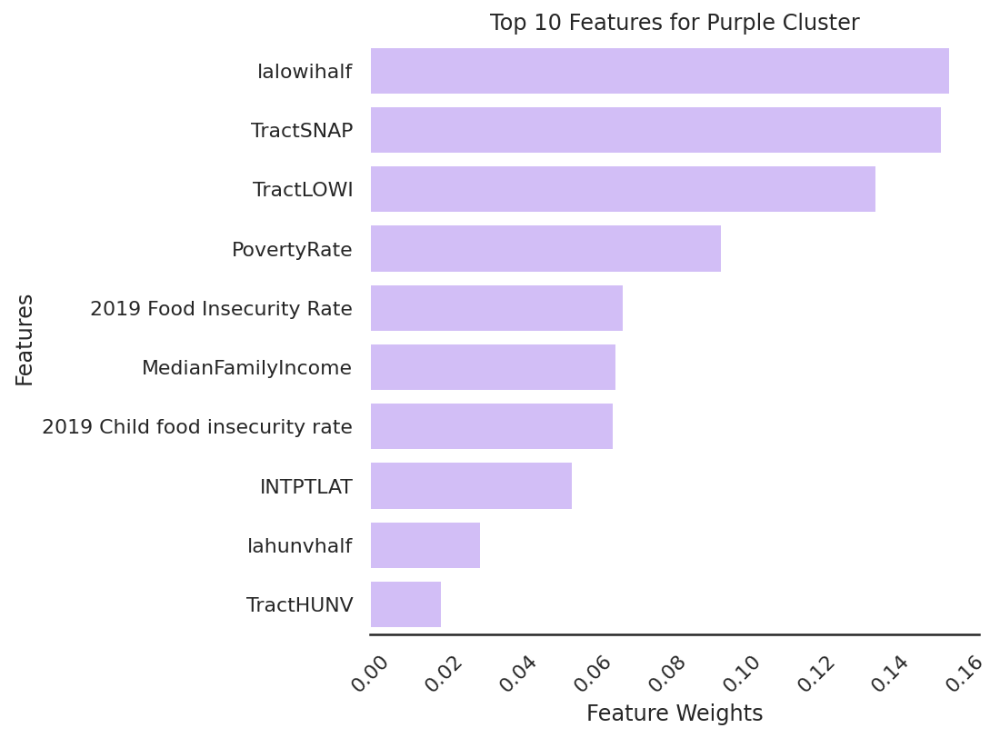

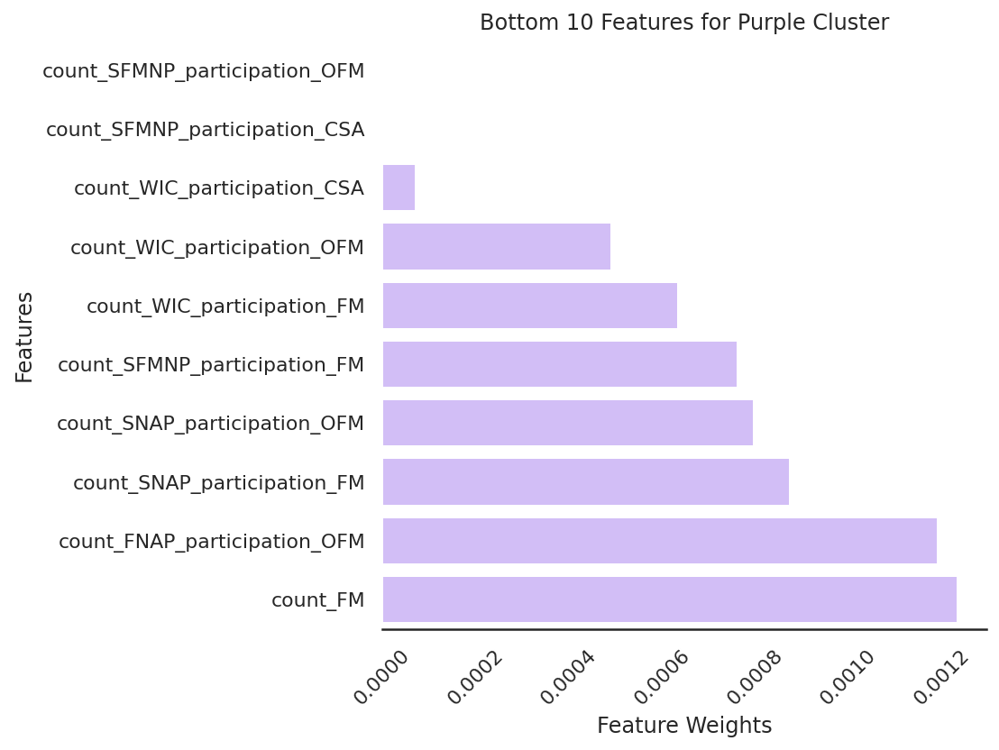

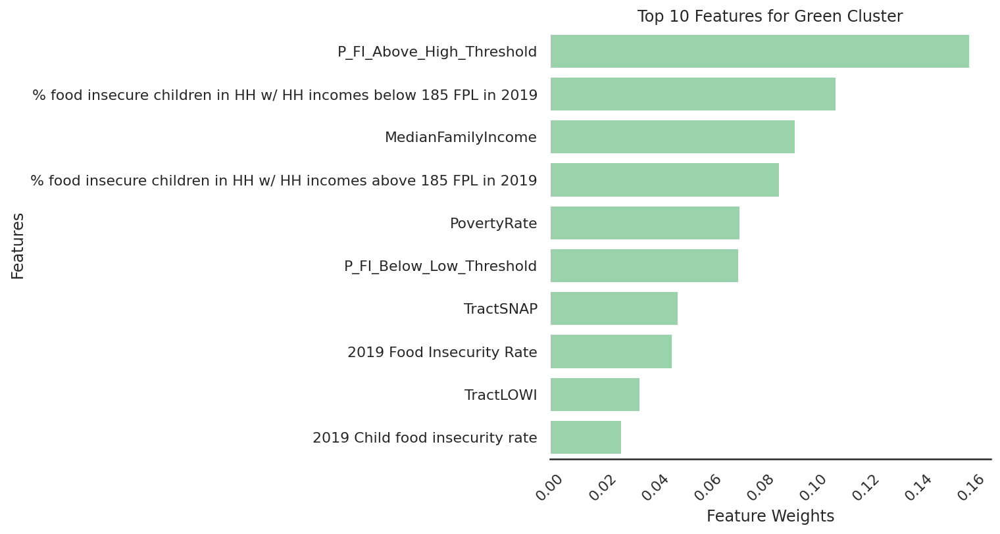

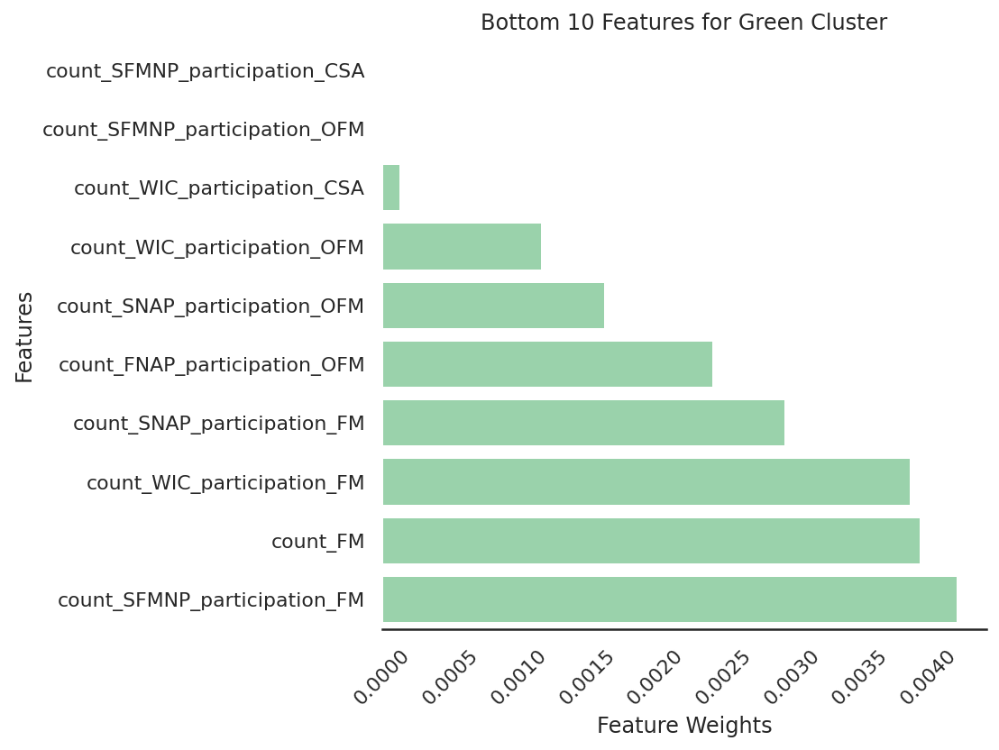

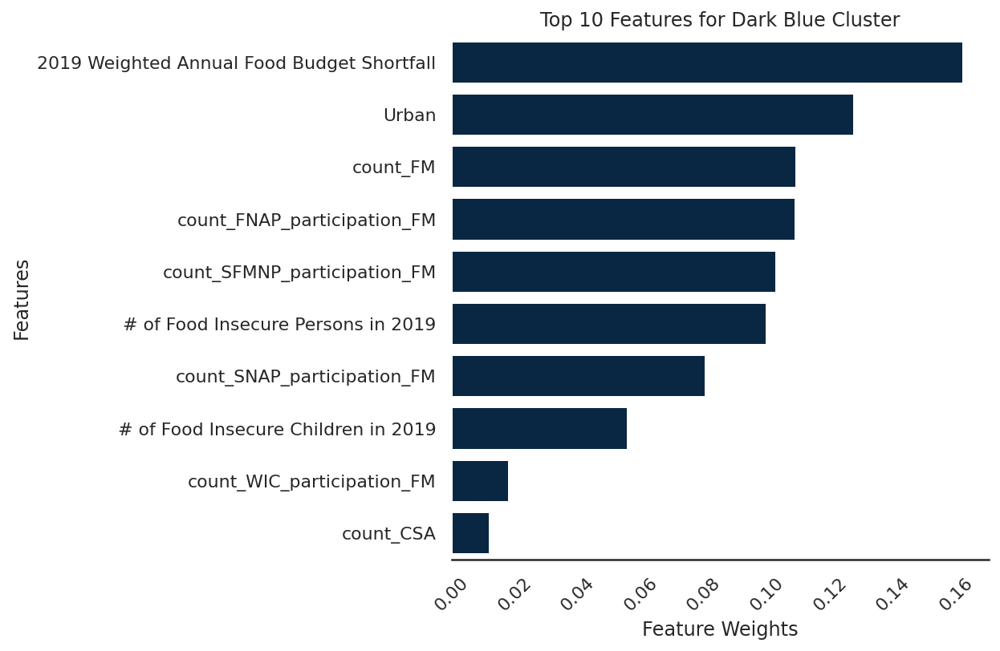

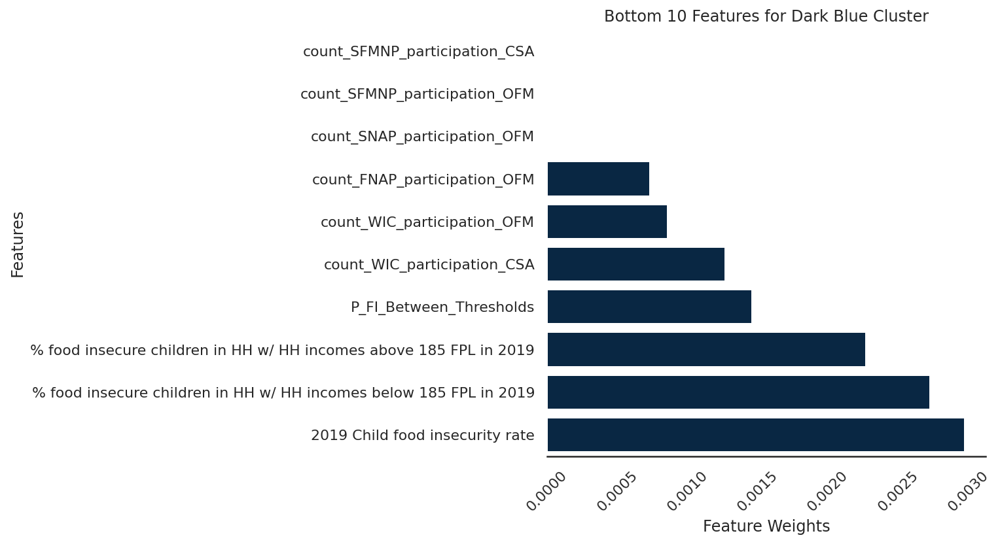

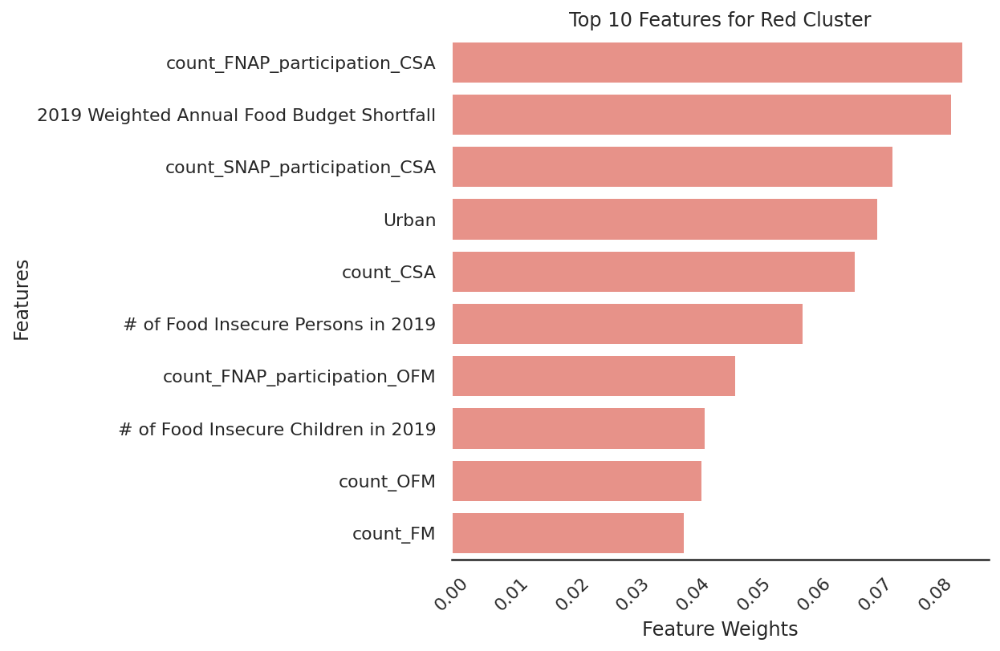

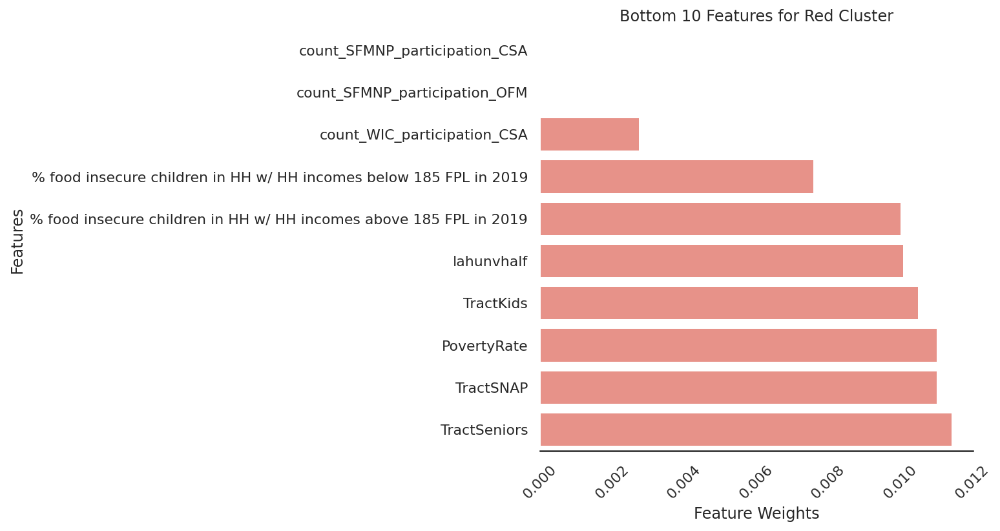

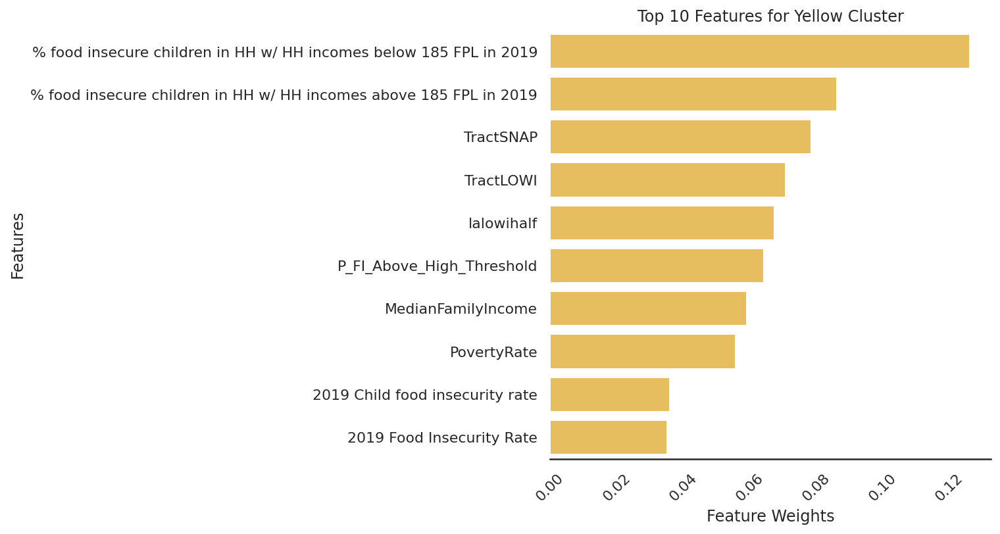

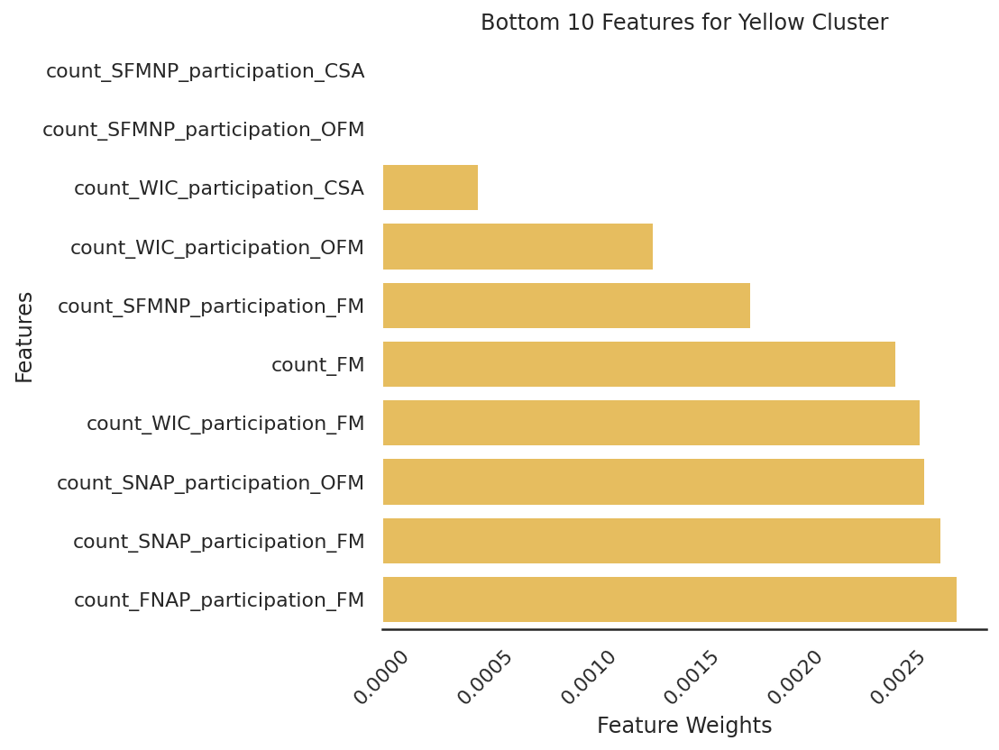

In [32]:
# Train basic RF to extract the features of the cluster
# Run for each cluster in the dataset

def features(df, clf):

  # Index sort the most important features
  sorted_feature_weight_idxes = np.argsort(clf.feature_importances_)[::-1] # Reverse sort

  # Get the most important features names and weights
  most_important_features = np.take_along_axis(
                            np.array(data_num_df2.columns.tolist()), 
                            sorted_feature_weight_idxes, axis=0)
  
  most_important_weights = np.take_along_axis(
                           np.array(clf.feature_importances_), 
                           sorted_feature_weight_idxes, axis=0)

  # Save as top 10 and bottom 10
  top_ten = list(zip(most_important_features, most_important_weights))[:10]
  bottom_ten = list(zip(most_important_features, most_important_weights))[-10:][::-1]
  
  return top_ten, bottom_ten



def view_bottom_features(bottom, color, cluster_type):
    set_matplotlib_formats('retina')
    plt.figure(figsize = (6,6))

    custom_params = {"axes.spines.right": False, "axes.spines.top": False,
                     "axes.spines.left": False}

    sns.set_theme(style="white", rc = custom_params)

    bottom_df = pd.DataFrame(bottom, columns = ['Features', 'Feature Weights'])

    # Wrap on whitespace with a max line length of 30 chars
    #top_df['Features'] = top_df['Features'].apply(wrap, args=[30])

    sns.barplot(x = bottom_df['Feature Weights'], 
                y = bottom_df['Features'], 
                color=color, 
                log=False
                )
    plt.xticks(rotation = 45)
    plt.title(f"Bottom 10 Features for {cluster_type} Cluster")
    plt.show()



def view_top_features(bottom, color, cluster_type):
    set_matplotlib_formats('retina')
    plt.figure(figsize = (6,6))

    custom_params = {"axes.spines.right": False, "axes.spines.top": False,
                     "axes.spines.left": False}

    sns.set_theme(style="white", rc = custom_params)

    top_df = pd.DataFrame(top, columns = ['Features', 'Feature Weights'])

    # Wrap on whitespace with a max line length of 30 chars
    #top_df['Features'] = top_df['Features'].apply(wrap, args=[30])

    sns.barplot(x = top_df['Feature Weights'], 
                y = top_df['Features'], 
                color=color, 
                log=False
                )
    plt.xticks(rotation = 45)
    plt.title(f"Top 10 Features for {cluster_type} Cluster")
    plt.show()

#Colors for 5 clusters
colors = [
'#CFB5FF',
'#91DBA8',
'#00274C',
'#F6867A',
'#FCC649']

cluster_names = [
'Purple Cluster 0', 
'Green Cluster 1', 
'Dark Blue Cluster 2',
'Red Cluster 3', 
'Yellow Cluster 4']

"""
#CFB5FF 0 - Purple
#91DBA8 1 - Green
#00274C 2 - Dark Blue
#F6867A 3 - Red
#FCC649 4 - Yellow
"""
# Map the color to the cluster
mapped_color_cluster = list(zip(colors, cluster_names))

for color, cluster_type in mapped_color_cluster:
  # Train RFC
  clf = RandomForestClassifier(random_state=1)
  clf.fit(data_num_df2.values, data_num_df[cluster_type].values)

  cluster_color_str = re.findall(r'.+?(?= Cluster)', cluster_type)[0]

  # Get Features
  top, bottom = features(data_num_df2, clf)

  # View horizontal bar of Top
  view_top_features(top, color, cluster_color_str)

  # View horizontal bar of Bottom
  view_bottom_features(bottom, color, cluster_color_str)

## Top and Bottom Features shared between the Clusters

- data below was collected by changing the variable names and storing individually then running the cells below after all clusters were trained with RF and the top and bottom features were determined. 

In [216]:
# TOP 
print("yellow and red clusters both share: ", set([x[0] for x in topy]).intersection(set([x[0] for x in topr])))
print("yellow and dark blue clusters both share: ",set([x[0] for x in topy]).intersection(set([x[0] for x in topd])))
print("yellow and green clusters both share: ",set([x[0] for x in topy]).intersection(set([x[0] for x in topg])))
print("yellow and purple clusters both share: ",set([x[0] for x in topy]).intersection(set([x[0] for x in topp])))
print("red and dark blue clusters both share: ", set([x[0] for x in topr]).intersection(set([x[0] for x in topd])))
print("red and green clusters both share: ",set([x[0] for x in topr]).intersection(set([x[0] for x in topg])))
print("red and purple clusters both share: ",set([x[0] for x in topr]).intersection(set([x[0] for x in topp])))
print("dark blue and green clusters both share: ",set([x[0] for x in topd]).intersection(set([x[0] for x in topg])))
print("dark blue and purple clusters both share: ",set([x[0] for x in topd]).intersection(set([x[0] for x in topp])))
print("green and purple clusters both share: ",set([x[0] for x in topg]).intersection(set([x[0] for x in topp])))



one = set([x[0] for x in topy]).intersection(set([x[0] for x in topr]))| set([x[0] for x in topy]).intersection(set([x[0] for x in topd]))
two = set([x[0] for x in topy]).intersection(set([x[0] for x in topg]))| one
three = set([x[0] for x in topy]).intersection(set([x[0] for x in topp]))| two
four = set([x[0] for x in topr]).intersection(set([x[0] for x in topd]))| three
five = set([x[0] for x in topr]).intersection(set([x[0] for x in topg]))| four
six = set([x[0] for x in topr]).intersection(set([x[0] for x in topp]))| five 
seven = set([x[0] for x in topd]).intersection(set([x[0] for x in topg]))| six
eight = set([x[0] for x in topd]).intersection(set([x[0] for x in topp]))| seven
nine = set([x[0] for x in topg]).intersection(set([x[0] for x in topp])) | eight


nine

yellow and red clusters both share:  set()
yellow and dark blue clusters both share:  set()
yellow and green clusters both share:  {'% food insecure children in HH w/ HH incomes below 185 FPL in 2019', '2019 Food Insecurity Rate', 'P_FI_Above_High_Threshold', 'PovertyRate', 'TractLOWI', 'TractSNAP', 'MedianFamilyIncome', '% food insecure children in HH w/ HH incomes above 185 FPL in 2019', '2019 Child food insecurity rate'}
yellow and purple clusters both share:  {'2019 Food Insecurity Rate', 'PovertyRate', 'TractLOWI', 'lalowihalf', 'TractSNAP', 'MedianFamilyIncome', '2019 Child food insecurity rate'}
red and dark blue clusters both share:  {'count_CSA', '# of Food Insecure Persons in 2019', '# of Food Insecure Children in 2019', 'Urban', '2019 Weighted Annual Food Budget Shortfall', 'count_FM'}
red and green clusters both share:  set()
red and purple clusters both share:  set()
dark blue and green clusters both share:  set()
dark blue and purple clusters both share:  set()
green and 

{'# of Food Insecure Children in 2019',
 '# of Food Insecure Persons in 2019',
 '% food insecure children in HH w/ HH incomes above 185 FPL in 2019',
 '% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
 '2019 Child food insecurity rate',
 '2019 Food Insecurity Rate',
 '2019 Weighted Annual Food Budget Shortfall',
 'MedianFamilyIncome',
 'P_FI_Above_High_Threshold',
 'PovertyRate',
 'TractLOWI',
 'TractSNAP',
 'Urban',
 'count_CSA',
 'count_FM',
 'lalowihalf'}

In [218]:
# Bottom 
print("yellow and red clusters both share: ", set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomr])))
print("yellow and dark blue clusters both share: ",set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomd])))
print("yellow and green clusters both share: ",set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomg])))
print("yellow and purple clusters both share: ",set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomp])))
print("red and dark blue clusters both share: ", set([x[0] for x in bottomr]).intersection(set([x[0] for x in bottomd])))
print("red and green clusters both share: ",set([x[0] for x in bottomr]).intersection(set([x[0] for x in bottomg])))
print("red and purple clusters both share: ",set([x[0] for x in bottomr]).intersection(set([x[0] for x in bottomp])))
print("dark blue and green clusters both share: ",set([x[0] for x in bottomd]).intersection(set([x[0] for x in bottomg])))
print("dark blue and purple clusters both share: ",set([x[0] for x in bottomd]).intersection(set([x[0] for x in bottomp])))
print("green and purple clusters both share: ",set([x[0] for x in bottomg]).intersection(set([x[0] for x in bottomp])))


one = set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomr]))| set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomd]))
two = set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomg]))| one
three = set([x[0] for x in bottomy]).intersection(set([x[0] for x in bottomp]))| two
four = set([x[0] for x in bottomr]).intersection(set([x[0] for x in bottomd]))| three
five = set([x[0] for x in bottomr]).intersection(set([x[0] for x in bottomg]))| four
six = set([x[0] for x in bottomr]).intersection(set([x[0] for x in bottomp]))| five 
seven = set([x[0] for x in bottomd]).intersection(set([x[0] for x in bottomg]))| six
eight = set([x[0] for x in bottomd]).intersection(set([x[0] for x in bottomp]))| seven
nine = set([x[0] for x in bottomg]).intersection(set([x[0] for x in bottomp])) | eight

nine

yellow and red clusters both share:  {'count_SFMNP_participation_CSA', 'count_SFMNP_participation_OFM', 'count_WIC_participation_CSA'}
yellow and dark blue clusters both share:  {'count_SNAP_participation_OFM', 'count_SFMNP_participation_OFM', 'count_WIC_participation_OFM', 'count_WIC_participation_CSA', 'count_SFMNP_participation_CSA'}
yellow and green clusters both share:  {'count_SNAP_participation_OFM', 'count_SFMNP_participation_OFM', 'count_WIC_participation_OFM', 'count_SFMNP_participation_FM', 'count_WIC_participation_CSA', 'count_FM', 'count_SNAP_participation_FM', 'count_WIC_participation_FM', 'count_SFMNP_participation_CSA'}
yellow and purple clusters both share:  {'count_SNAP_participation_OFM', 'count_SFMNP_participation_OFM', 'count_WIC_participation_OFM', 'count_SFMNP_participation_FM', 'count_WIC_participation_CSA', 'count_FM', 'count_WIC_participation_FM', 'count_SNAP_participation_FM', 'count_SFMNP_participation_CSA'}
red and dark blue clusters both share:  {'% food i

{'% food insecure children in HH w/ HH incomes above 185 FPL in 2019',
 '% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
 'count_FM',
 'count_FNAP_participation_OFM',
 'count_SFMNP_participation_CSA',
 'count_SFMNP_participation_FM',
 'count_SFMNP_participation_OFM',
 'count_SNAP_participation_FM',
 'count_SNAP_participation_OFM',
 'count_WIC_participation_CSA',
 'count_WIC_participation_FM',
 'count_WIC_participation_OFM'}

In [288]:
#@title on scaled data with out lat and long, this takes the lat and long raw values and extracts them then adds back to scaled data
"""
X0 = data_num_df.iloc[:,-2].values.reshape(-1,1)
X1 = data_num_df.iloc[:,-1].values.reshape(-1,1)
Xnew = np.hstack((X_std,X0))
X_stand = np.hstack((Xnew, X1))
X_stand.shape"""

(3136, 38)

# DBSCAN
http://www2.cs.uh.edu/~ceick/7363/Papers/dbscan.pdf

[Article on definitions below](https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc)

- **eps**: Two points are considered neighbors if the distance between the two points is below the threshold epsilon.
- **min_samples**: The minimum number of neighbors a given point should have in order to be classified as a core point. It’s important to note that the point itself is included in the minimum number of samples.
- **metric**: The metric to use when calculating distance between instances in a feature array (i.e. euclidean distance).


In [41]:
# Use KNN to observe epsilon value
# use 2 neighbors to calculate the distance between two points. One point to all other points, so
# on and so forth

clf = knn(n_neighbors=2)
knn_model = clf.fit(X_std)
distances, indices = knn_model.kneighbors(X_std)
print(distances, indices)

[[0.         1.47687511]
 [0.         3.76454555]
 [0.         1.48613385]
 ...
 [0.         2.39436959]
 [0.         1.41256961]
 [0.         1.66653166]] [[   0 1138]
 [   1  892]
 [   2 2137]
 ...
 [3133 2794]
 [3134 1652]
 [3135 2406]]


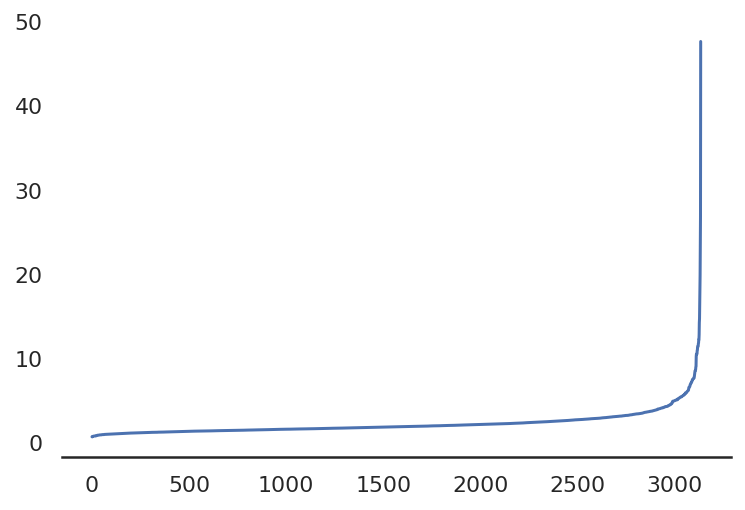

In [43]:
# sort distances and reverse to plot
distances = np.sort(distances, axis=0)
distances = distances[:,1] # inverse
plt.plot(distances)

In [93]:
#kms_per_radian = 6371.0088
#epsilon = 0.5 / kms_per_radian
epsilon = 5
model = DBSCAN(eps=epsilon, min_samples=5).fit(X_std)
clusters = model.labels_

data_num_df['CLUSTERS_DBSCAN'] = clusters

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [94]:
data_num_df['CLUSTERS_DBSCAN'].unique()

array([ 0,  1, -1,  2,  3])

In [78]:
#X_std_df = pd.DataFrame(X_std, columns= data_num_df2.columns)


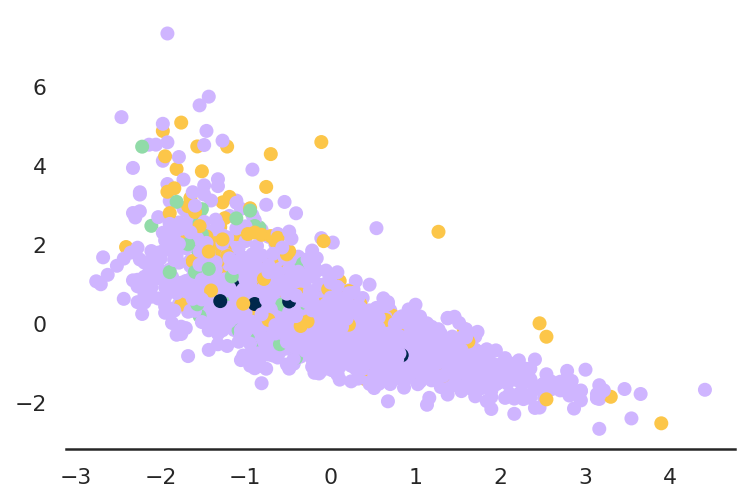

In [64]:
# Not clustering well
# food insecurity score 2019 vs MedianFamilyIncome 

colors = [
'#CFB5FF',
'#91DBA8',
'#00274C', 
'#FCC649', ]
vectorizer = np.vectorize(lambda x: colors[x % len(colors)])


plt.scatter(X_std[:,0], X_std[:,35], c=vectorizer(clusters))

plt.show()

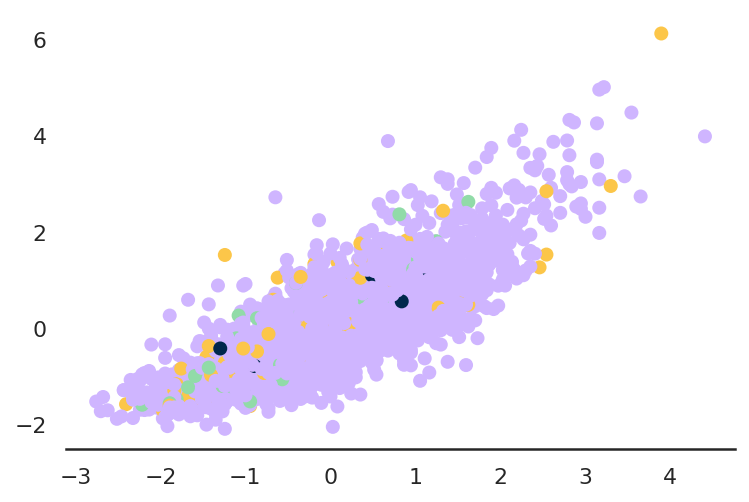

In [71]:
# Not clustering well
# food insecurity score 2019 vs Poverty Rate 
plt.scatter(X_std[:,0], X_std[:,31], c=vectorizer(clusters))

plt.show()

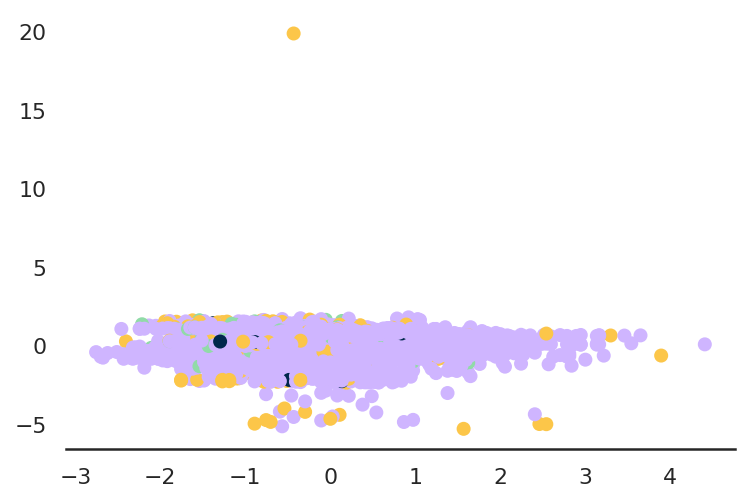

In [72]:
# Not clustering well
# food insecurity score 2019 vs longitude 
plt.scatter(X_std[:,0], X_std[:,37], c=vectorizer(clusters))

plt.show()

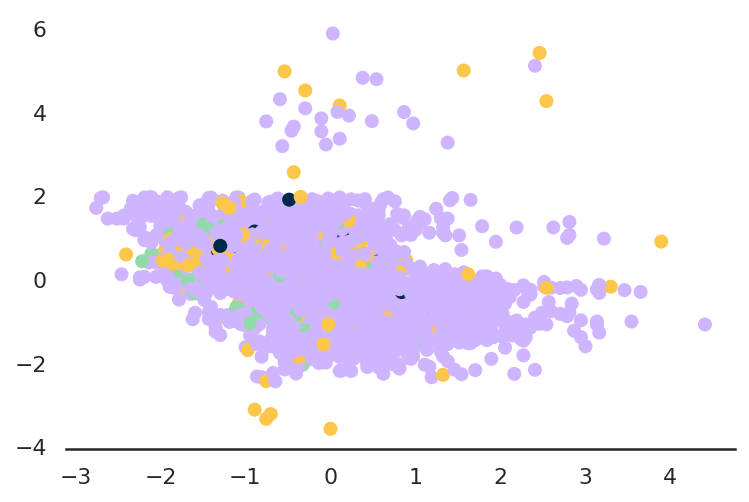

In [73]:
# Not clustering well
# food insecurity score 2019 vs latitude
plt.scatter(X_std[:,0], X_std[:,36], c=vectorizer(clusters))

plt.show()

In [137]:
colors = [
'#CFB5FF',
'#91DBA8',
'#00274C', 
'#FCC649', ]

m = folium.Map(location=[data_num_df.INTPTLAT.mean(), data_num_df.INTPTLONG.mean()], zoom_start=9, 
               tiles='cartodbpositron')
for i, row in data_num_df.iterrows():
  if row['CLUSTERS_DBSCAN'] == -1:
            cluster_color = '#000000'
  else:
    cluster_color = colors[row['CLUSTERS_DBSCAN']]
    #print(cluster_color, row['clusters'])
    folium.CircleMarker(
            location=[row.INTPTLAT, row.INTPTLONG],
            radius=.25,
            popup=re.sub(r'[^a-zA-Z ]+', '', row.County),
            color=cluster_color,
            fill=True,
            opacity=0.5,
            fill_color=cluster_color
        ).add_to(m)

m

### Just get rows with farmers locations

In [96]:
farmer_df = pd.read_csv('/content/gdrive/MyDrive/FIS/count_by_county_FM_CSA_OFM_20220716.csv')
main_df = pd.read_csv('/content/gdrive/MyDrive/FIS/team20_clean_MM_FA_FM_county_202207191713.csv')

In [97]:
farmer_df

,Unnamed: 0,state_n_county,count_OFM,count_SNAP_participation_OFM,count_FNAP_participation_OFM,count_WIC_participation_OFM,count_SFMNP_participation_OFM,count_CSA,count_SNAP_participation_CSA,count_FNAP_participation_CSA,...,count_FM,count_SNAP_participation_FM,count_FNAP_participation_FM,count_WIC_participation_FM,count_SFMNP_participation_FM,block_fips,state_fips,state,county,county_fips
0,0,"Alabama,Baldwin County",4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,10030109042009,AL,Alabama,Baldwin County,1003
1,1,"Alabama,Blount County",3.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,10090501053016,AL,Alabama,Blount County,1009
2,2,"Alabama,Chilton County",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,10210604011001,AL,Alabama,Chilton County,1021
3,3,"Alabama,Coosa County",1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,10379612003042,AL,Alabama,Coosa County,1037
4,4,"Alabama,Cullman County",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,10439649012023,AL,Alabama,Cullman County,1043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1387,1387,"Wyoming,Converse County",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,560099566001106,WY,Wyoming,Converse County,56009
1388,1388,"Wyoming,Goshen County",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,560159580002173,WY,Wyoming,Goshen County,56015
1389,1389,"Wyoming,Natrona County",0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,560250007003017,WY,Wyoming,Natrona County,56025
1390,1390,"Wyoming,Sheridan County",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,560330001004005,WY,Wyoming,Sheridan County,56033


In [106]:
just_fm_df = farmer_df.merge(main_df, left_on = 'county_fips', right_on = 'FIPS')
just_fm_df = just_fm_df.merge(lat_long_df)
just_fm_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1388 entries, 0 to 1387
Data columns (total 69 columns):
 #   Column                                                              Non-Null Count  Dtype  
---  ------                                                              --------------  -----  
 0   Unnamed: 0_x                                                        1388 non-null   int64  
 1   state_n_county                                                      1388 non-null   object 
 2   count_OFM_x                                                         1388 non-null   float64
 3   count_SNAP_participation_OFM_x                                      1388 non-null   float64
 4   count_FNAP_participation_OFM_x                                      1388 non-null   float64
 5   count_WIC_participation_OFM_x                                       1388 non-null   float64
 6   count_SFMNP_participation_OFM_x                                     1388 non-null   float64
 7   count_CSA_x    

In [107]:
just_fm_df.columns

Index(['Unnamed: 0_x', 'state_n_county', 'count_OFM_x',
       'count_SNAP_participation_OFM_x', 'count_FNAP_participation_OFM_x',
       'count_WIC_participation_OFM_x', 'count_SFMNP_participation_OFM_x',
       'count_CSA_x', 'count_SNAP_participation_CSA_x',
       'count_FNAP_participation_CSA_x', 'count_WIC_participation_CSA_x',
       'count_SFMNP_participation_CSA_x', 'count_FM_x',
       'count_SNAP_participation_FM_x', 'count_FNAP_participation_FM_x',
       'count_WIC_participation_FM_x', 'count_SFMNP_participation_FM_x',
       'block_fips', 'state_fips', 'state', 'county', 'county_fips',
       'Unnamed: 0_y', 'FIPS', 'State', '2019 Food Insecurity Rate',
       '# of Food Insecure Persons in 2019', 'Low Threshold in state',
       'Low Threshold Type', 'High Threshold in state', 'High Threshold Type',
       '2019 Child food insecurity rate',
       '# of Food Insecure Children in 2019',
       '% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
       '%

In [117]:
print(just_fm_df['Low Threshold in state'].unique())
print(just_fm_df['High Threshold in state'].unique())
print(just_fm_df['Low Threshold Type'].unique())
print(just_fm_df['High Threshold Type'].unique())

[130 185 200 165 160]
[185 200]
['SNAP' 'SNAP, Other Nutrition Programs']
['Other Nutrition Program' 'SNAP, Other Nutrition Programs']


In [118]:
columns_to_keep = [
'count_OFM_x',
'count_SNAP_participation_OFM_x', 
'count_FNAP_participation_OFM_x',
'count_WIC_participation_OFM_x', 
'count_SFMNP_participation_OFM_x',
'count_CSA_x', 
'count_SNAP_participation_CSA_x',
'count_FNAP_participation_CSA_x', 
'count_WIC_participation_CSA_x',
'count_SFMNP_participation_CSA_x', 
'count_FM_x',
'count_SNAP_participation_FM_x', 
'count_FNAP_participation_FM_x',
'count_WIC_participation_FM_x', 
'count_SFMNP_participation_FM_x',
'2019 Food Insecurity Rate',
'# of Food Insecure Persons in 2019', 
#'Low Threshold in state',
#'Low Threshold Type', 
#'High Threshold in state', 
#'High Threshold Type',
'2019 Child food insecurity rate',
'# of Food Insecure Children in 2019',
'% food insecure children in HH w/ HH incomes below 185 FPL in 2019',
'% food insecure children in HH w/ HH incomes above 185 FPL in 2019',
'2019 Cost Per Meal', 
'2019 Weighted Annual Food Budget Shortfall',
'P_FI_Below_Low_Threshold', 
'P_FI_Between_Thresholds',
'P_FI_Above_High_Threshold', 
'TractSNAP', 
'TractHUNV', 
'TractKids', 
'TractSeniors', 
'lahunvhalf',
'LALOWI05_10', 
'PovertyRate', 
'lalowihalf', 
'TractLOWI', 
'Urban',
'MedianFamilyIncome',
'INTPTLAT',
'INTPTLONG'
]                  
cleaned_just_df = just_fm_df[columns_to_keep]
cleaned_just_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1388 entries, 0 to 1387
Data columns (total 39 columns):
 #   Column                                                              Non-Null Count  Dtype  
---  ------                                                              --------------  -----  
 0   count_OFM_x                                                         1388 non-null   float64
 1   count_SNAP_participation_OFM_x                                      1388 non-null   float64
 2   count_FNAP_participation_OFM_x                                      1388 non-null   float64
 3   count_WIC_participation_OFM_x                                       1388 non-null   float64
 4   count_SFMNP_participation_OFM_x                                     1388 non-null   float64
 5   count_CSA_x                                                         1388 non-null   float64
 6   count_SNAP_participation_CSA_x                                      1388 non-null   float64
 7   count_FNAP_part

In [122]:
cleaned_just_df = cleaned_just_df.dropna()
X_scaled_fm = StandardScaler().fit_transform(cleaned_just_df)
X_scaled_fm

array([[ 2.06075306,  2.26710406,  2.01066677, ...,  0.21950246,
        -1.72515827,  0.1732327 ],
       [ 1.32659646,  2.26710406,  2.01066677, ..., -0.48613512,
        -1.04474122,  0.25842092],
       [-0.14171673, -0.3449941 , -0.35947763, ..., -0.68734433,
        -1.2750863 ,  0.24685426],
       ...,
       [-0.87587333, -0.3449941 , -0.35947763, ...,  0.47808027,
         0.80085564, -1.20047546],
       [-0.87587333, -0.3449941 , -0.35947763, ...,  0.56841956,
         1.17072688, -1.20863531],
       [-0.87587333, -0.3449941 , -0.35947763, ...,  0.39280952,
         0.978964  , -1.04172981]])

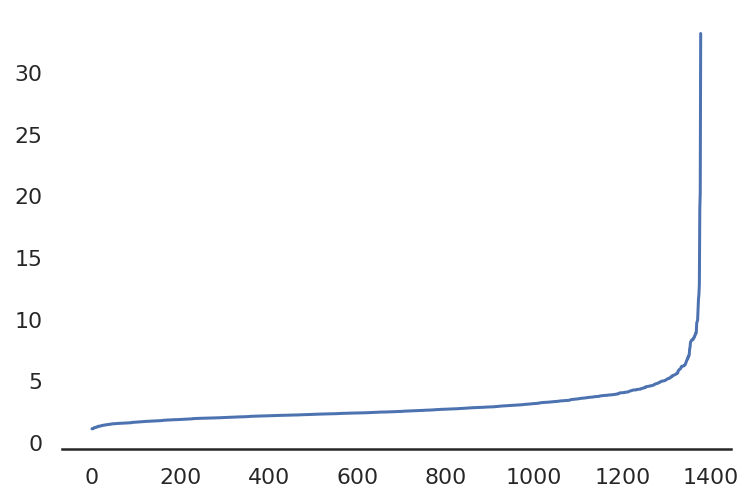

In [123]:
clf = knn(n_neighbors=2)
knn_model = clf.fit(X_scaled_fm)
distances, indices = knn_model.kneighbors(X_scaled_fm)

# sort distances and reverse to plot
distances = np.sort(distances, axis=0)
distances = distances[:,1] # inverse
plt.plot(distances)

In [131]:
epsilon = 3
model = DBSCAN(eps=epsilon, min_samples=4).fit(X_scaled_fm)
clusters = model.labels_

cleaned_just_df['CLUSTERS_DBSCAN'] = clusters
cleaned_just_df['CLUSTERS_DBSCAN'].unique()

array([-1,  0,  2,  1,  3])

In [133]:
cleaned_just_df

,count_OFM_x,count_SNAP_participation_OFM_x,count_FNAP_participation_OFM_x,count_WIC_participation_OFM_x,count_SFMNP_participation_OFM_x,count_CSA_x,count_SNAP_participation_CSA_x,count_FNAP_participation_CSA_x,count_WIC_participation_CSA_x,count_SFMNP_participation_CSA_x,...,lahunvhalf,LALOWI05_10,PovertyRate,lalowihalf,TractLOWI,Urban,MedianFamilyIncome,INTPTLAT,INTPTLONG,CLUSTERS_DBSCAN
0,4.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,70.270895,1054.515175,11.845546,1552.104536,1865.903226,31.0,72665.741935,30.659218,-87.746067,-1
1,3.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,91.316874,2038.838706,14.850748,2200.824287,2310.555556,9.0,60437.666667,33.977358,-86.566440,-1
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,83.488082,485.773567,17.910984,1883.379263,2005.888889,9.0,56950.888889,32.854051,-86.726607,0
3,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,66.208899,296.829976,14.026414,1486.502025,1425.000000,3.0,46510.666667,32.931445,-86.243482,0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,66.421676,741.610069,15.988238,1704.755757,1825.500000,18.0,53786.277778,34.131923,-86.869267,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1383,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,22.492679,458.565554,8.293275,608.502301,806.250000,4.0,81785.250000,42.984623,-105.524752,0
1384,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,13.928516,387.870579,11.276105,819.914900,970.250000,4.0,69323.750000,42.089455,-104.353540,0
1385,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,57.090687,810.783505,9.995474,879.226657,1170.222222,18.0,77146.666667,42.977645,-106.768219,0
1386,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,51.039695,745.044478,6.726357,963.065908,1207.166667,6.0,78712.166667,44.781369,-106.881211,0


In [162]:
colors = [
'#89045d',
'#08E8DE',
'#FFF000', 
'#FF007F']


m = folium.Map(location=[cleaned_just_df.INTPTLAT.mean(), cleaned_just_df.INTPTLONG.mean()], zoom_start=9, 
               tiles='cartodbpositron')
for i, row in cleaned_just_df.iterrows():
  if row['CLUSTERS_DBSCAN'] == -1:
    cluster_color = '#000000'
  else:

    #print(int(row['CLUSTERS_DBSCAN']))
    #print(colors[int(row['CLUSTERS_DBSCAN'])])
    cluster_color = colors[int(row['CLUSTERS_DBSCAN'])]
    #print(cluster_color, row['clusters'])
    folium.CircleMarker(
            location=[row.INTPTLAT, row.INTPTLONG],
            radius=1,
            #popup=re.sub(r'[^a-zA-Z ]+', '', row.County),
            color=cluster_color,
            fill=True,
            opacity=1,
            fill_color=cluster_color
        ).add_to(m)

m